In [1]:
# Initial imports
import pandas as pd
import hvplot.pandas
import plotly.express as px
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

from sklearn.datasets import make_classification



### Connect to Database

### Pull files (until SQL connection)

In [2]:
# Load the clean_indices.csv dataset
prices_df = pd.read_csv(r'../Resources/data/clean/clean_prices.csv', index_col = 0)
prices_df.head()

,"Crude oil, average","Crude oil, Brent","Crude oil, Dubai","Crude oil, WTI","Coal, Australian","Coal, South African **","Natural gas, US","Natural gas, Europe **","Liquefied natural gas, Japan",Natural gas index,...,Aluminum,"Iron ore, cfr spot",Copper,Lead,Tin,Nickel,Zinc,Gold,Platinum,Silver
Month,,,,,,,,,,,,,,,,,,,,,
2016M01,29.78,30.80,27.00,31.54,49.02,49.09,2.27,4.40,8.40,54.22,...,1481.10,41.88,4471.79,1646.20,13808.08,8507.29,1520.36,1097.91,855.25,14.11
2016M02,31.03,33.20,29.50,30.39,50.27,50.33,1.96,3.97,8.56,48.43,...,1531.26,46.83,4598.62,1765.75,15610.14,8298.50,1709.85,1199.50,919.35,15.17
2016M03,37.34,39.07,35.18,37.77,52.21,52.57,1.70,3.91,7.74,44.49,...,1531.01,56.20,4953.80,1802.19,16897.60,8717.25,1801.69,1245.14,967.73,15.47
2016M04,40.75,42.25,39.04,40.96,50.69,52.35,1.90,3.97,6.82,46.63,...,1571.23,60.92,4872.74,1732.27,17032.71,8878.86,1855.37,1242.26,994.19,16.36
2016M05,45.94,47.13,43.95,46.73,51.31,54.24,1.92,4.33,6.27,48.17,...,1550.63,55.13,4694.54,1707.80,16706.95,8660.35,1869.03,1260.95,1035.86,16.95


In [3]:
# Select only index and "Natural gas, US" column and count NULL values

energy_prices =  prices_df["Natural gas, US"]

energy_prices

Month
2016M01    2.27
2016M02    1.96
2016M03    1.70
2016M04    1.90
2016M05    1.92
           ... 
2021M08    4.05
2021M09    5.11
2021M10    5.48
2021M11    5.02
2021M12    3.73
Name: Natural gas, US, Length: 72, dtype: float64

In [4]:
# Import contract data
prices_df = pd.read_csv(r'../Resources/data/clean/clean_contracts.csv', index_col = 0)

# Rename column to Month
prices_df.head()

,naics_description,product_or_service_code_description,total_obligated_amount,recipient_name,funding_sub_agency_name
Month,,,,,
2016M01,ALL OTHER NONMETALLIC MINERAL MINING,"MINERAL CONSTRUCTION MATERIALS, BULK",3127.50,PRIME ONE GENERAL TRADING & CONTRACTING CO. WLL,DEPT OF THE AIR FORCE
2016M01,ALL OTHER NONMETALLIC MINERAL MINING,"MINERAL CONSTRUCTION MATERIALS, BULK",3968.67,PRIME ONE GENERAL TRADING & CONTRACTING CO. WLL,DEPT OF THE AIR FORCE
2016M01,BITUMINOUS COAL UNDERGROUND MINING,"FUELS, SOLID",351038.45,"DELTA COALS, LLC",DEPT OF THE NAVY
2016M01,CONSTRUCTION SAND AND GRAVEL MINING,"BUILDING COMPONENTS, PREFABRICATED",10341.15,MISCELLANEOUS FOREIGN AWARDEES,"STATE, DEPARTMENT OF"
2016M01,CONSTRUCTION SAND AND GRAVEL MINING,CONSTRUCTION OF AMMUNITION FACILITIES,140539.74,FOREIGN AWARDEES (UNDISCLOSED),"STATE, DEPARTMENT OF"


### Join Contracts and Price indicies

In [5]:
index_df = prices_df.join(energy_prices, on='Month', how='left')

In [6]:
index_df.head()

,naics_description,product_or_service_code_description,total_obligated_amount,recipient_name,funding_sub_agency_name,"Natural gas, US"
Month,,,,,,
2016M01,ALL OTHER NONMETALLIC MINERAL MINING,"MINERAL CONSTRUCTION MATERIALS, BULK",3127.50,PRIME ONE GENERAL TRADING & CONTRACTING CO. WLL,DEPT OF THE AIR FORCE,2.27
2016M01,ALL OTHER NONMETALLIC MINERAL MINING,"MINERAL CONSTRUCTION MATERIALS, BULK",3968.67,PRIME ONE GENERAL TRADING & CONTRACTING CO. WLL,DEPT OF THE AIR FORCE,2.27
2016M01,BITUMINOUS COAL UNDERGROUND MINING,"FUELS, SOLID",351038.45,"DELTA COALS, LLC",DEPT OF THE NAVY,2.27
2016M01,CONSTRUCTION SAND AND GRAVEL MINING,"BUILDING COMPONENTS, PREFABRICATED",10341.15,MISCELLANEOUS FOREIGN AWARDEES,"STATE, DEPARTMENT OF",2.27
2016M01,CONSTRUCTION SAND AND GRAVEL MINING,CONSTRUCTION OF AMMUNITION FACILITIES,140539.74,FOREIGN AWARDEES (UNDISCLOSED),"STATE, DEPARTMENT OF",2.27


In [7]:
# Rename Gas Price Column
index_df.rename(columns={'Natural gas, US':'us_nat_gas_price'}, inplace=True)

# Check for NAs
index_df.isna().sum()

naics_description                      0
product_or_service_code_description    0
total_obligated_amount                 0
recipient_name                         0
funding_sub_agency_name                0
us_nat_gas_price                       0
dtype: int64

In [8]:
# Check Data types
index_df.dtypes

naics_description                       object
product_or_service_code_description     object
total_obligated_amount                 float64
recipient_name                          object
funding_sub_agency_name                 object
us_nat_gas_price                       float64
dtype: object

In [9]:
# What is the distribution of US Nat gas prices?
index_df.groupby("us_nat_gas_price").size()
index_df["us_nat_gas_price"].value_counts()

2.96    641
1.92    485
2.79    399
2.95    330
2.94    314
2.97    283
1.74    264
3.08    258
2.89    241
2.58    239
2.98    236
2.67    210
5.11    209
2.88    203
2.83    200
2.80    198
2.78    196
2.65    180
2.57    161
2.63    160
2.22    159
1.70    154
1.90    150
2.76    150
2.70    146
3.12    143
3.28    141
3.86    141
2.86    139
2.72    137
2.99    133
4.05    133
1.79    124
2.40    124
2.36    123
1.75    121
2.33    120
2.24    118
2.25    115
3.26    114
4.13    114
2.03    114
3.98    113
1.96    113
2.50    113
2.27    110
2.82    107
2.61    106
3.80    106
3.23    105
1.61    102
3.58     98
2.56     93
2.30     92
5.07     83
2.54     77
2.59     76
Name: us_nat_gas_price, dtype: int64

### View the data

In [10]:
X = index_df.us_nat_gas_price
y = index_df.total_obligated_amount

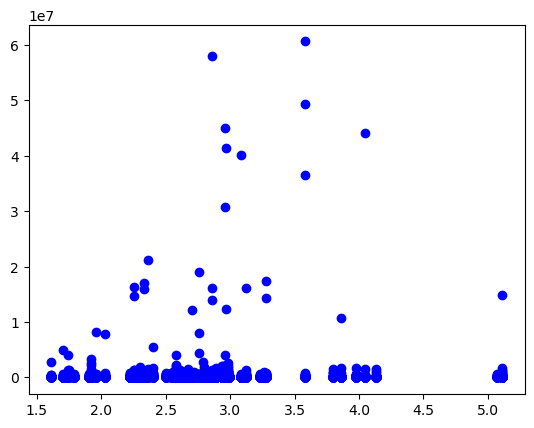

In [11]:
plt.scatter(X, y, c='blue')

### Encode the data

In [12]:
contracts_binary_encoded = pd.get_dummies(index_df, columns=["naics_description","product_or_service_code_description","recipient_name","funding_sub_agency_name"])

### Scale the data

In [13]:
contracts_binary_encoded

,total_obligated_amount,us_nat_gas_price,naics_description_ALL OTHER METAL ORE MINING,naics_description_ALL OTHER NONMETALLIC MINERAL MINING,naics_description_BITUMINOUS COAL AND LIGNITE SURFACE MINING,naics_description_BITUMINOUS COAL UNDERGROUND MINING,naics_description_CLAY AND CERAMIC AND REFRACTORY MINERALS MINING,naics_description_CONSTRUCTION SAND AND GRAVEL MINING,naics_description_COPPER ORE AND NICKEL ORE MINING,"naics_description_COPPER, NICKEL, LEAD, AND ZINC MINING",...,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICE,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICEDEPT OF THE AIR FORCEU.S. ARMY CORPS OF ENGINEERS - CIVIL PROGRAM FINANCING ONLYU.S. ARMY CORPS OF ENGINEERS - CIVIL PROGRAM FINANCING ONLYU.S. FISH AND WILDLIFE SERVICEU.S. ARMY CORPS OF ENGINEERS - CIVIL PROGRAM FINANCING ONLY,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICENATIONAL PARK SERVICE,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICEU.S. FISH AND WILDLIFE SERVICE,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICEU.S. FISH AND WILDLIFE SERVICEU.S. FISH AND WILDLIFE SERVICE,funding_sub_agency_name_U.S. SPECIAL OPERATIONS COMMAND (USSOCOM),"funding_sub_agency_name_UNITED STATES AGENCY FOR GLOBAL MEDIA, BBG",funding_sub_agency_name_US GEOLOGICAL SURVEY,"funding_sub_agency_name_VETERANS AFFAIRS, DEPARTMENT OF","funding_sub_agency_name_VETERANS AFFAIRS, DEPARTMENT OFDEPT OF THE ARMY"
Month,,,,,,,,,,,,,,,,,,,,,
2016M01,3127.50,2.27,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,3968.67,2.27,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,351038.45,2.27,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,10341.15,2.27,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,140539.74,2.27,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021M09,103769.92,5.11,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2021M09,208971.00,5.11,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2021M09,256047.00,5.11,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [14]:
index_scaled = StandardScaler().fit_transform(contracts_binary_encoded)
print(index_scaled)

[[-0.08090295 -0.74705856 -0.04951243 ... -0.06477061 -0.12458541
  -0.01009483]
 [-0.08035541 -0.74705856 -0.04951243 ... -0.06477061 -0.12458541
  -0.01009483]
 [ 0.14556155 -0.74705856 -0.04951243 ... -0.06477061 -0.12458541
  -0.01009483]
 ...
 [ 0.08372909  3.47730322 -0.04951243 ... -0.06477061 -0.12458541
  -0.01009483]
 [ 0.14078346  3.47730322 -0.04951243 ... -0.06477061 -0.12458541
  -0.01009483]
 [ 0.17585239  3.47730322 -0.04951243 ... -0.06477061 -0.12458541
  -0.01009483]]


In [15]:
len(index_scaled)

9814

In [16]:
# Applying PCA to create 4 dementions

# Initialize PCA model
pca = PCA(n_components=4, random_state=1)

# Get two principal components for the iris data.
index_pca = pca.fit_transform(index_scaled)

In [17]:
# Transform PCA data to a DataFrame
df_index_pca = pd.DataFrame(
    data=index_pca, columns=["PC1", "PC2","PC3","PC4"]
)
df_index_pca.head()

,PC1,PC2,PC3,PC4
0,1.615318,-0.278528,0.059592,0.537030
1,1.615325,-0.278506,0.059570,0.537034
2,0.779422,2.417216,1.105844,1.245586
3,1.853767,-1.517035,-3.603202,1.893113
4,1.844361,-1.630329,-2.762966,1.416577


In [18]:
1-sum(list(pca.explained_variance_ratio_))

0.9945827392926909

In [19]:
# Fetch the explained variance
total = 0
for x in pca.explained_variance_ratio_:
    total+=x
total

0.005417260707309074

In [20]:
pca.explained_variance_ratio_

array([0.00174715, 0.00125028, 0.00122135, 0.00119849])

## Running KMeans with PCA Data

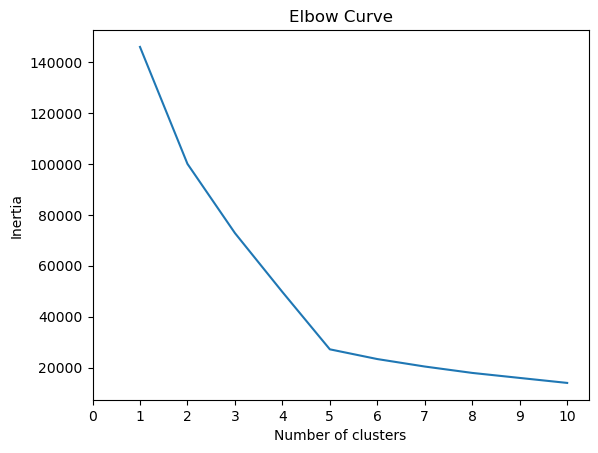

In [21]:
# Finding the best value for k
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of k values
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(df_index_pca)
    inertia.append(km.inertia_)

# Creating the Elbow Curve
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)

plt.plot(df_elbow['k'], df_elbow['inertia'])
plt.xticks(list(range(11)))
plt.title('Elbow Curve')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

In [22]:
# Predicting clusters with k=3

# Initialize the k-means model
model = KMeans(n_clusters=3, random_state=0)

# Fit the model
model.fit(df_index_pca)

# Predict clusters
predictions = model.predict(df_index_pca)

# Add the predicted class column to the dataframe
df_index_pca["class"] = model.labels_
df_index_pca.head()

,PC1,PC2,PC3,PC4,class
0,1.615318,-0.278528,0.059592,0.537030,2
1,1.615325,-0.278506,0.059570,0.537034,2
2,0.779422,2.417216,1.105844,1.245586,0
3,1.853767,-1.517035,-3.603202,1.893113,2
4,1.844361,-1.630329,-2.762966,1.416577,2


In [27]:
# Visualize the clusters
df_index_pca.hvplot.scatter(x="PC1", y="PC2", color="class")

:Scatter   [PC1]   (PC2,class)

In [35]:
index_df.head()

,naics_description,product_or_service_code_description,total_obligated_amount,recipient_name,funding_sub_agency_name,us_nat_gas_price
Month,,,,,,
2016M01,ALL OTHER NONMETALLIC MINERAL MINING,"MINERAL CONSTRUCTION MATERIALS, BULK",3127.50,PRIME ONE GENERAL TRADING & CONTRACTING CO. WLL,DEPT OF THE AIR FORCE,2.27
2016M01,ALL OTHER NONMETALLIC MINERAL MINING,"MINERAL CONSTRUCTION MATERIALS, BULK",3968.67,PRIME ONE GENERAL TRADING & CONTRACTING CO. WLL,DEPT OF THE AIR FORCE,2.27
2016M01,BITUMINOUS COAL UNDERGROUND MINING,"FUELS, SOLID",351038.45,"DELTA COALS, LLC",DEPT OF THE NAVY,2.27
2016M01,CONSTRUCTION SAND AND GRAVEL MINING,"BUILDING COMPONENTS, PREFABRICATED",10341.15,MISCELLANEOUS FOREIGN AWARDEES,"STATE, DEPARTMENT OF",2.27
2016M01,CONSTRUCTION SAND AND GRAVEL MINING,CONSTRUCTION OF AMMUNITION FACILITIES,140539.74,FOREIGN AWARDEES (UNDISCLOSED),"STATE, DEPARTMENT OF",2.27


In [39]:
# predictions
index_clone = index_df.reset_index(drop=False)
index_clone

df2 = index_clone[["total_obligated_amount","us_nat_gas_price", 'Month']]
df2["class"] = predictions
df2

C:\Users\Chapm\.conda\envs\PythonData\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,total_obligated_amount,us_nat_gas_price,Month,class
0,3127.50,2.27,2016M01,2
1,3968.67,2.27,2016M01,2
2,351038.45,2.27,2016M01,0
3,10341.15,2.27,2016M01,2
4,140539.74,2.27,2016M01,2
...,...,...,...,...
9809,103769.92,5.11,2021M09,2
9810,208971.00,5.11,2021M09,2
9811,256047.00,5.11,2021M09,2
9812,343698.00,5.11,2021M09,2


In [40]:
# Plot the 3 principal components
import plotly.express as px
fig = px.scatter_3d(
    df2,
    x="total_obligated_amount",
    y="us_nat_gas_price",
    z="Month",
    color="class",
    symbol="class",
    width=800,
)
fig.update_layout(legend=dict(x=0, y=1))
fig.show()

# Random Forest Classifier

In [42]:
index_clone = contracts_binary_encoded.copy()
index_clone.head()

,total_obligated_amount,us_nat_gas_price,naics_description_ALL OTHER METAL ORE MINING,naics_description_ALL OTHER NONMETALLIC MINERAL MINING,naics_description_BITUMINOUS COAL AND LIGNITE SURFACE MINING,naics_description_BITUMINOUS COAL UNDERGROUND MINING,naics_description_CLAY AND CERAMIC AND REFRACTORY MINERALS MINING,naics_description_CONSTRUCTION SAND AND GRAVEL MINING,naics_description_COPPER ORE AND NICKEL ORE MINING,"naics_description_COPPER, NICKEL, LEAD, AND ZINC MINING",...,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICE,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICEDEPT OF THE AIR FORCEU.S. ARMY CORPS OF ENGINEERS - CIVIL PROGRAM FINANCING ONLYU.S. ARMY CORPS OF ENGINEERS - CIVIL PROGRAM FINANCING ONLYU.S. FISH AND WILDLIFE SERVICEU.S. ARMY CORPS OF ENGINEERS - CIVIL PROGRAM FINANCING ONLY,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICENATIONAL PARK SERVICE,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICEU.S. FISH AND WILDLIFE SERVICE,funding_sub_agency_name_U.S. FISH AND WILDLIFE SERVICEU.S. FISH AND WILDLIFE SERVICEU.S. FISH AND WILDLIFE SERVICE,funding_sub_agency_name_U.S. SPECIAL OPERATIONS COMMAND (USSOCOM),"funding_sub_agency_name_UNITED STATES AGENCY FOR GLOBAL MEDIA, BBG",funding_sub_agency_name_US GEOLOGICAL SURVEY,"funding_sub_agency_name_VETERANS AFFAIRS, DEPARTMENT OF","funding_sub_agency_name_VETERANS AFFAIRS, DEPARTMENT OFDEPT OF THE ARMY"
Month,,,,,,,,,,,,,,,,,,,,,
2016M01,3127.50,2.27,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,3968.67,2.27,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,351038.45,2.27,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,10341.15,2.27,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2016M01,140539.74,2.27,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [43]:
X = index_clone.drop('us_nat_gas_price', axis=1)
y = index_clone.us_nat_gas_price

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1)
scaler = StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [46]:
clf = RandomForestRegressor(random_state=1, n_estimators=40).fit(X_train_scaled, y_train)
print(f'Training Score: {clf.score(X_train_scaled, y_train)}')
print(f'Testing Score: {clf.score(X_test_scaled, y_test)}')

Training Score: 0.8174968142063129
Testing Score: -0.14194043543283819


In [47]:
feature_importances = clf.feature_importances_

In [48]:
features = sorted(zip(X.columns, clf.feature_importances_), key = lambda x: x[1])
cols = [f[0] for f in features]
width = [f[1] for f in features]

fig, ax = plt.subplots()

fig.set_size_inches(10,200)
plt.margins(y=0.001)

ax.barh(y=cols, width=width)

plt.show()

## Hierarchical Clustering

In [ ]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import fcluster, linkage, dendrogram
import pandas as pd
import numpy as np
from pathlib import Path

In [ ]:
labels = pd.DataFrame(index=index_df.index)

data = index_df.reset_index(drop=True)
data.head()

In [ ]:
len(labels)

In [ ]:
mergings = linkage(data, method='ward')

In [ ]:
plt.figure(figsize=(14,6))
dendrogram(mergings,
          labels=np.array(labels),
          leaf_rotation=90,
          leaf_font_size=12)
plt.show()

### Testing below this line